In [1]:
import pandas as pd
from dataprep.eda import create_report
import numpy as np
import warnings
warnings.filterwarnings('ignore',category=FutureWarning)

# Data Checking

## Objective
1. Focus on removing unusable data
2. Check typo
3. Generalize if possible

  0%|          | 0/1704 [00:00<?, ?it/s]

c:\Users\Rifqi-Yunus\anaconda3\Lib\site-packages\dask\core.py:121: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))
c:\Users\Rifqi-Yunus\anaconda3\Lib\site-packages\dask\core.py:121: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))


DataPrep Report
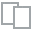
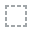
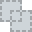
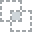
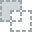
...
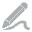
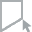
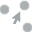
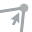
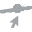

In [2]:
# Balikpapan
path_file = 'data\BALIKPAPAN.xlsx'

df = pd.read_excel(path_file)
create_report(df)

In [3]:
df = df[['JAM DOWN', 'START DATE','KAB/KOTA', 'ROOTCAUSE', 'CUSTOMER', 'INCIDENT ID', 'TANGGAL PENGERJAAN', 'JAM UP', 'STATUS']]
df.columns = df.columns.str.lower().str.replace(' ', '_')
df.head(20)

,jam_down,start_date,kab/kota,rootcause,customer,incident_id,tanggal_pengerjaan,jam_up,status
0,<NA>,2023-10-01,Kota Balikpapan,Putus Kabel,SUCI,23103100143,2023-10-01,16.34,✅
1,<NA>,2023-10-01,penajam,Core Crack/Bending,SAPARUDDIN RT 2SBW,23103100163,2023-10-01,15.26,✅
2,<NA>,2023-10-01,Kota Balikpapan,Bukan Gangguan,SUHARIYANTO,23103100023,2023-10-01,22.00,✅
3,<NA>,2023-10-01,Kota Balikpapan,Putus Kabel,FITRIANI,23103100212,2023-10-02,11.47,✅
4,<NA>,2023-10-01,Kota Balikpapan,Putus Kabel,TAMSIR,23103100253,2023-10-02,15.00,✅
5,<NA>,2023-10-02,Kota Balikpapan,Putus Kabel,MARIANA,23103100308,2023-10-02,16.15,✅
6,<NA>,2023-10-02,Kota Balikpapan,Putus Kabel,ANI DWI RAHAYU,23103100358,2023-10-02,17.29,✅
7,<NA>,2023-10-01,Kota Balikpapan,Bad Performance Perangkat,ZAENAL ABIDIN,23103100225,2023-10-03,10.31,✅
8,<NA>,2023-10-02,Penajam Paser Utara,Kabel DW Rusak,SYIFA BAYU ADIYATMA,23103100582,2023-10-03,09.43,✅
9,<NA>,2023-10-03,Penajam Paser Utara,Putus Kabel,SERLINA KIDING ALLO,23103100626,2023-10-03,23.23,✅


### Clean Kota Kabupaten

In [4]:
unique_kab_kota_normal = list(df['kab/kota'].dropna().unique())
unique_kab_kota_capitalized = [item.title() for item in unique_kab_kota_normal]
set(unique_kab_kota_capitalized)

{'Grogot',
 'Kab. Penajam Paser Utara',
 'Kota Balikappan',
 'Kota Balikpapan',
 'Paser',
 'Penajam',
 'Penajam Paser Utara'}

In [5]:
corrections = {
    'Grogot':'Paser',
    'Kab. Penajam Paser Utara' : 'Penajam Paser Utara',
    'Kota Balikappan' : 'Kota Balikpapan',
    'Penajam' : 'Penajam Paser Utara',
    'Nan': None}

### Clean Jam dan Tanggal
Cek row with wrong data format

In [6]:
df['jam_down'] = df['jam_down'].str.strip().str.replace('.',':').str.replace(':::',':').str.replace('::',':').str.replace(',',':').str.replace('l',':').str.replace('2023-','').str.replace('-',':').str.replace(' 00:00:00','')
df['jam_up'] = df['jam_up'].str.strip().str.replace('.',':').str.replace('::',':').str.replace(',',':').str.replace(' ','')

for entry in df['jam_down']:
    try:
        pd.to_datetime(entry, format='%H:%M')
    except ValueError:
        print(ValueError);
        print(f"Problematic entry: {entry}")

# df_cleaned.loc[df_cleaned['jam_up'] =='1458',['jam_up']] = '14:58'
# df_cleaned.loc[df_cleaned['jam_up'] =='10:10:',['jam_up']] = '10:10'
# df_cleaned.loc[df_cleaned['jam_down'] =='10:50:',['jam_down']] = '10:50'
# df_cleaned.loc[df_cleaned['jam_down'] =='1122',['jam_down']] = '11:22'
# df_cleaned.loc[df_cleaned['jam_down'] =='1808',['jam_down']] = '18:08'
# df_cleaned.loc[df_cleaned['jam_down'] =='8:01',['jam_down']] = '08:01'
# df_cleaned.loc[df_cleaned['jam_down'] =='8:09',['jam_down']] = '08:09'
# df_cleaned.loc[df_cleaned['jam_down'] =='8:31',['jam_down']] = '08:31'
# df_cleaned.loc[df_cleaned['jam_down'] =='8:41',['jam_down']] = '08:41'
# df_cleaned.loc[df_cleaned['jam_down'] =='8:52',['jam_down']] = '08:52'
# df_cleaned.loc[df_cleaned['jam_down'] =='9:40',['jam_down']] = '09:40'
# df_cleaned.loc[df_cleaned['jam_down'] =='15:166',['jam_down']] = '15:16'

<class 'ValueError'>
Problematic entry: 10:50:


## Clean Final

In [7]:
# Fungsi untuk membersihkan dan memformat ulang DataFrame
def clean_data(df):
    # Filter baris dengan ikon checklist hijau pada kolom 'STATUS'
    df_cleaned = df[df['status'] == '✅'].copy()

    # Mengisi nilai NaN pada 'jam_down' dengan "00.00" dan pada 'jam_up' dengan "20.00"
    df_cleaned['jam_down'].fillna("00.00", inplace=True)
    df_cleaned['jam_up'].fillna("20.00", inplace=True)

    # Memastikan semua entri pada 'kab/kota' adalah string dan memformatnya menjadi huruf kapital awal
    df_cleaned['kab/kota'] = df_cleaned['kab/kota'].astype(str).str.title().str.strip()

    return df_cleaned

# Menerapkan fungsi pembersihan pada DataFrame
df_cleaned = clean_data(df)

# Penyesuaian dan koreksi lebih lanjut
corrections = {
    'Grogot':'Paser',
    'Kab. Penajam Paser Utara' : 'Penajam Paser Utara',
    'Kota Balikappan' : 'Kota Balikpapan',
    'Penajam' : 'Penajam Paser Utara',
    'Nan': None}

df_cleaned['kab/kota'] = df_cleaned['kab/kota'].replace(corrections)
df_cleaned['kab/kota'] = df_cleaned['kab/kota'].str.strip()

# Mengganti nilai None dengan 'NaN' atau np.nan berdasarkan tipe data kolom
def replace_none_values(df):
    for col in df.columns:
        if df[col].dtype == 'object':  # untuk kolom string
            df[col] = df[col].replace({None: 'NaN'})
        elif np.issubdtype(df[col].dtype, np.number):  # untuk kolom numerik
            df[col] = df[col].replace({None: np.nan})
    return df

df_cleaned = replace_none_values(df_cleaned)

# Drop some false row
rows_to_drop = df_cleaned[df_cleaned['incident_id'] == 'soon']
df_cleaned = df_cleaned.drop(rows_to_drop.index)

# Memformat ulang jam_down dan jam_up
df_cleaned['jam_down'] = df_cleaned['jam_down'].str.strip().str.replace('.',':').str.replace(':::',':').str.replace('::',':').str.replace(',',':').str.replace('l',':')
df_cleaned['jam_up'] = df_cleaned['jam_up'].str.strip().str.replace('.',':').str.replace('::',':').str.replace(',',':').str.replace(' ','')

# Correction Time Values
df_cleaned.loc[df_cleaned['jam_up'] =='1458',['jam_up']] = '14:58'
df_cleaned.loc[df_cleaned['jam_up'] =='10:10:',['jam_up']] = '10:10'
df_cleaned.loc[df_cleaned['jam_down'] =='10:50:',['jam_down']] = '10:50'

# Mengonversi jam_down dan jam_up menjadi format waktu
df_cleaned['jam_down'] = pd.to_datetime(df_cleaned['jam_down'], format='%H:%M').dt.time
df_cleaned['jam_up'] = pd.to_datetime(df_cleaned['jam_up'], format='%H:%M').dt.time

# Menggabungkan tanggal dengan waktu
df_cleaned['time_down'] = pd.to_datetime(df_cleaned['start_date'].astype(str) + ' ' + df_cleaned['jam_down'].astype(str), format='%Y-%m-%d %H:%M:%S', errors='coerce')
df_cleaned['time_up'] = pd.to_datetime(df_cleaned['tanggal_pengerjaan'].astype(str) + ' ' + df_cleaned['jam_up'].astype(str), format='%Y-%m-%d %H:%M:%S', errors='coerce')

df_cleaned.drop(columns=['jam_down', 'jam_up','start_date', 'tanggal_pengerjaan', 'status'], inplace=True)   
df_cleaned['customer-kota'] = df_cleaned['customer'].astype(str) + ' ' + df_cleaned['kab/kota'].astype(str)
df_cleaned

,kab/kota,rootcause,customer,incident_id,time_down,time_up,customer-kota
0,Kota Balikpapan,Putus Kabel,SUCI,23103100143,2023-10-01 00:00:00,2023-10-01 16:34:00,SUCI Kota Balikpapan
1,Penajam Paser Utara,Core Crack/Bending,SAPARUDDIN RT 2SBW,23103100163,2023-10-01 00:00:00,2023-10-01 15:26:00,SAPARUDDIN RT 2SBW Penajam Paser Utara
2,Kota Balikpapan,Bukan Gangguan,SUHARIYANTO,23103100023,2023-10-01 00:00:00,2023-10-01 22:00:00,SUHARIYANTO Kota Balikpapan
3,Kota Balikpapan,Putus Kabel,FITRIANI,23103100212,2023-10-01 00:00:00,2023-10-02 11:47:00,FITRIANI Kota Balikpapan
4,Kota Balikpapan,Putus Kabel,TAMSIR,23103100253,2023-10-01 00:00:00,2023-10-02 15:00:00,TAMSIR Kota Balikpapan
...,...,...,...,...,...,...,...
644,Kota Balikpapan,Putus Kabel,HASANUDDIN,23113108573,2023-11-29 19:26:00,2023-12-01 09:24:00,HASANUDDIN Kota Balikpapan
645,Kota Balikpapan,Kabel DW Rusak,MUHAMMAD SAID KURNIAWAN (MJI),23113108630,2023-11-29 21:34:00,2023-12-01 18:02:00,MUHAMMAD SAID KURNIAWAN (MJI) Kota Balikpapan
646,Penajam Paser Utara,Kabel DW Rusak,(AFB) SARIYOKO,23113108937,2023-11-30 22:19:00,2023-12-01 09:53:00,(AFB) SARIYOKO Penajam Paser Utara
647,Penajam Paser Utara,Kabel DW Rusak,ROSMIATI,23113108905,2023-11-30 19:16:00,2023-12-01 18:06:00,ROSMIATI Penajam Paser Utara


  0%|          | 0/674 [00:00<?, ?it/s]

c:\Users\Rifqi-Yunus\anaconda3\Lib\site-packages\dask\core.py:121: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))


DataPrep Report
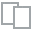
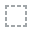
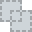
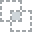
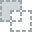
...
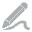
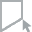
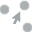
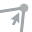
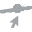

In [8]:
create_report(df_cleaned)

In [10]:
df_cleaned.to_excel('data/BALIKPAPAN_clean.xlsx')